# Assignment 12 - Physics-informed Neural Networks (Total 20 Points)
<span style='color:red'> Due date: 27.07.2021 23:59</span>

This week's assignment is about Physics-informed Neural Networks and **optional**, meaning that the points count towards your balance, but are not considered for calculating the 80% minimum requirement. If anything is unclear or if you find errors, feel free to post in the forum set up in Ilias or ask in the WebEx live session, or write an email to one of us.

_You can submit incomplete assignments that don't validate_. If a test cell validates correctly, you will get the points. If test cells don't validate, you may still get at least partial points.

Let's eplore the idea of PINNs on a simple example problem. Recall the heat diffusion problem from assignment 10, described by the PDE

$$ f(x,t) = \frac{\partial u(x,t)}{\partial t} - a \frac{\partial^2 u(x,t)}{\partial x^2} = 0 $$

$u$ is the temperature field, $x$ and $t$ are the spatial and temporal coordinates, defining the problem domain and $a$ is the thermal conductivity. The idea is to have a 1-dimensional beam that was heated up and to compute the transient behavior of the beam cooling down. Space and time, as well as the temperature, are normalized to $x, t, u \in [0,1]$. We'll use the `adam` optimizer here for simplicity, but keep in mind that second order optimizers like `L-BFGS` work *much* better.

First, import everything we need later on:

In [1]:
import time
from tensorflow import Variable, GradientTape
from tensorflow import convert_to_tensor, reduce_mean, square, stack
from tensorflow import random as tf_random
from tensorflow.keras import Sequential
from tensorflow.keras.layers import InputLayer, Dense, Lambda
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.backend import clear_session
from tensorflow.keras.layers.experimental.preprocessing import Rescaling
import numpy as np
from pyDOE import lhs
import matplotlib.pyplot as plt
from sklearn.utils.extmath import cartesian
from IPython.display import clear_output

# this makes tensorflow run in graph mode
# i.e., the compute graph will be create and optimized
# before running the actual model
# try to run everything without this function call
tf.config.run_functions_eagerly(False)

The function below creates the training data. This includes collocation points for enforcing the boundary conditions as well as collocation points inside the domain. For completely understanding what this data portrays, it makes sense to run everything in the function body on its own and look at what the shapes and contents of each array are. The `x_full_grid` array for example contains all pairs of `x`- and `t`-components to form a grid on the PDE domain, on which the PINN will later predict the corresponding field values.

The analytical solution was computed using a Fourier series up to machine precision.

In [2]:
def data_in(boundary_collocation_points, inner_collocation_points):
    # create spacetime mesh
    t = np.linspace(0, 1, 101)
    x = np.linspace(0, 1, 101)
    
    # load exact/analytical solution
    # this could also be experimental or numerical data, but with caveats
    exact_u = np.load('sol.npy')
    
    # "reverse" cartesian product, creates all pairs (x_i, t_i)
    # this is the grid the model will later predict on
    x_full_grid = cartesian([t,x])
    # columns need to be switched for later
    x_full_grid[:,[0, 1]] = x_full_grid[:,[1, 0]]
    
    # spatial domain boundaries for easy access
    lower_boundary = x_full_grid.min(axis=0)
    upper_boundary = x_full_grid.max(axis=0)
    
    idx = np.random.choice(x_full_grid.shape[0], boundary_collocation_points, replace=False)
    
    # initial_conditions at t=0
    x_0 = cartesian([x, t[:1]])
    u_0 = exact_u[:,0:1]
    
    # lower boundary conditions at x=0
    x_lb = cartesian([x[:1], t]) 
    u_lb = exact_u[0:1,:].T
    
    # upper boundary conditions at x=1
    x_ub = cartesian([x[-1:], t]) 
    u_ub = exact_u[-1:,:].T
    
    # stack the boundary conditions
    x_u_train = np.vstack([x_0, x_lb, x_ub])
    u_train   = np.vstack([u_0, u_lb, u_ub])
    
    # generate collocation points for the inner domain using Latin Hypercube Sampling
    x_f_train = lower_boundary + (upper_boundary-lower_boundary) * lhs(2, inner_collocation_points)
    
    # generate uniform random sample indices for boundary collocation points
    idx = np.random.choice(x_u_train.shape[0], boundary_collocation_points, replace=False)
    # get corresponding input coordinates from x_u_train
    x_u_train = x_u_train[idx,:]
    # get corresponding field values from u_train
    u_train = u_train[idx,:]
    
    return x, t, exact_u, x_full_grid, x_u_train, u_train, x_f_train, upper_boundary, lower_boundary

The sampling for the inner collocation points is done using *latin hypercube sampling*. This basically splits the domain evenly into a grid and makes sure that in each row and each column only a single data point is sampled. It should be less prone to leaving unexplored areas:

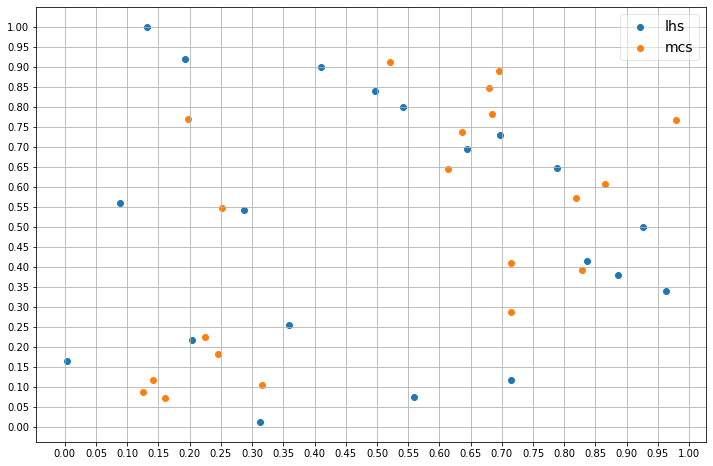

In [3]:
lb = np.zeros((1,2))
ub = np.ones((1,2))

n_points = 20

col_lhs = lb + (ub-lb) * lhs(2, n_points)
col_mcs = np.random.rand(n_points, 2)

plt.figure(figsize=(12,8))

plt.scatter(col_lhs[:,0], col_lhs[:,1], label="lhs")
plt.scatter(col_mcs[:,0], col_mcs[:,1], label="mcs")

major_ticks = np.linspace(0, 1, n_points+1)

plt.xticks(major_ticks)
plt.yticks(major_ticks)

plt.grid(which='both')

plt.legend(fontsize=14, framealpha=0.5)

The following function helps with the plotting. It's both used for the optional callback function that outputs plots during training and the final plot in the end. It is highly suggested to leave the custom callback off, since plotting takes a *very long* time. Without the callback, optimizing the PINN over 1000 epochs takes less than 40 seconds. With the callback it takes around an hour(!).

As an exercise for yourself, try implementing slices through space that work like the time slices in the generated plots. 

In [4]:
def plot_2d(u_pred, 
            x_u_train, 
            u_train, 
            exact_u, 
            x, 
            t, 
            t_slices, 
            error_plot=False, 
            loss_plot=False,
            losses=None,
            epochs=None,
            pltind=False, 
            pltpath=None):
    
    
    grid_rows = 2
    if error_plot: grid_rows += 1
    if loss_plot:  grid_rows += 1
    
    fig, ax = plt.subplots(figsize=(10,4+grid_rows), dpi=300)
    
    gs1 = fig.add_gridspec(grid_rows, len(t_slices), wspace=0.85, hspace=0.55) ## adjust depending on grid_rows?
    
    #gs0.update(top=0.95, bottom=0.05, left=0.05, right=0.95, wspace=0)
    
    # loss plots
    # ToDo: include validation losses later
    if loss_plot:
        axs = [plt.subplot(gs1[0, :len(t_slices)//2 ]), 
               plt.subplot(gs1[0,  len(t_slices)//2:2*len(t_slices)//2-len(t_slices)%2])]
        
        loss_name = ["PINN loss", "RMS loss"]
        for i,loss in enumerate(losses):
            axs[i].plot(range(len(loss)), loss, lw=3, label=loss_name[i])
            axs[i].set_xlim([0,epochs])
            axs[i].legend()
            
    
    # predicted field plot
    ax = plt.subplot(gs1[1 if loss_plot else 0, :])
    
    h = ax.imshow(u_pred, interpolation='nearest', cmap='viridis', 
                  extent=[t.min(), t.max(), x.min(), x.max()], vmin=0, vmax=1,
                  origin='lower', aspect='auto') 
    fig.colorbar(h,ax=ax)
    
    ax.plot(x_u_train[:,1], x_u_train[:,0], 'kx', label = 'Data (%d points)' \
            % (u_train.shape[0]), markersize = 4, clip_on = False, color="darkorange", zorder=1000)
    line = np.linspace(x.min(), x.max(), 2)[:,None]
    for t_slice in t_slices[1:-1]:
        ax.plot(t[t_slice]*np.ones((2,1)), line, 'w-', linewidth = 1)

    ax.set_xlabel('$t$')
    ax.set_ylabel('$x$')
    ax.legend(frameon=False, loc = 'best', labelcolor="white")
    ax.set_title('$u(x,t)$', fontsize = 10)
    
    # error plot
    if error_plot:
        ax = plt.subplot(gs1[2 if loss_plot else 1, :])
        
        error = u_pred-exact_u
        
        h = ax.imshow(error, interpolation='nearest', cmap='Spectral', 
                      extent=[t.min(), t.max(), x.min(), x.max()], 
                      vmin=-np.abs(error).max(), vmax=np.abs(error).max(),
                      origin='lower', aspect='auto') 
        fig.colorbar(h,ax=ax)
        
        line = np.linspace(x.min(), x.max(), 2)[:,None]
        for t_slice in t_slices[1:-1]:
            ax.plot(t[t_slice]*np.ones((2,1)), line, 'w-', linewidth = 1)
        
        ax.set_xlabel('$t$')
        ax.set_ylabel('$x$')
        #ax.legend(frameon=False, loc = 'best', labelcolor="white") ## Mark training and validation collocation points?
        ax.set_title(r'$\hat{u} - u$', fontsize = 10)
    
    # plot time slices
    for i,t_slice in enumerate(t_slices):
        ax = plt.subplot(gs1[-1, i])
        ax.plot(x,exact_u[:,t_slice], 'b-', linewidth = 2, label = 'Exact')       
        ax.plot(x,u_pred[:,t_slice], 'r--', linewidth = 2, label = 'Prediction')
        ax.set_xlabel('$x$')
        ax.set_ylabel(f'$u(x,{t_slice})$')
        ax.axis('square')
        ax.set_xlim([-0.1,1.1])
        ax.set_ylim([-0.1,1.1])
        ax.set_title(f'$t = {t_slice}$', fontsize = 10)
        
    if loss_plot:
        plt.suptitle(f"Epoch {len(losses[0])}", fontsize=16)
    elif epochs:
        plt.suptitle(f"{epochs} epochs", fontsize=16)
    
    
    if pltind and pltpath: 
        plt.savefig(pltpath, dpi=300)
    plt.show()
    

The custom callback:

In [5]:
class CustomCallback(Callback):
    def __init__(self, epochs, t_slices=range(0,101,25), animation=False, validation=False):
        self.epochs = epochs
        self.t_slices = t_slices
        self.animation = animation
        self.validation = validation
        
    def on_train_begin(self, logs={}):
        self.x = []
        self.loss = []
        self.metric = []
        if self.validation:
            self.val_loss = []
            self.val_metric = []
            

    def on_epoch_end(self, epoch, logs={}):
        self.x.append(epoch)
        self.loss.append(logs["loss"])
        self.metric.append(logs["root_mean_squared_error"])
        if self.validation:
            self.val_loss.append(logs["val_loss"])
            self.val_metric.append(logs["val_root_mean_squared_error"])
        
        
        self.u_pred = self.model.predict(x_full_grid).reshape(len(x),len(t),order='F')
        
        clear_output(wait=True)
        
        if self.animation:
            plot_2d(self.u_pred, x_u_train, u_train, exact_u, x, t, self.t_slices, True, True, [self.loss, self.metric], self.epochs, True, f'Anim/1D_Heat_{self.x[-1]}')
        else:
            plot_2d(self.u_pred, x_u_train, u_train, exact_u, x, t, self.t_slices, True, True, [self.loss, self.metric], self.epochs, False, '1D_Heat')


And now the heart of this exercise, the PINN itself. Let's encapsulate the functionality, it will give you an idea for how to generalize this to arbitrary PDEs.  

The `__init__()` function converts the `x` and `t` values to tensorflow tensors. It's not really necessary, but will generate a huge performance boost in connection with the `@tf.function` decorators. These tensors are set to *not trainable*, because they form the input to the PINN. The `__init__()` function also takes in the inner collocation points for the training, PDE parameters (in this case only the thermal conductivity), and the datatype, in this case `float32`.

The next method creates the actual ANN model to be fit to the PDE. The layers and activation functions are already given, but you hopefully see how you could generalize this easily. Complete the model in the following way:

#### 1. ANN
* Add an `InputLayer` to the model with the correct input size
* Add a `Rescaling` layer that rescales the inputs to the range $[-1, +1]$. See the [documentation](https://www.tensorflow.org/api_docs/python/tf/keras/layers/experimental/preprocessing/Rescaling) (if you're more comfortable with using Lambda layers, you can use that instead)
* Add hidden layers as defined in `layersizes` with activation set to `activation` and `glorot_uniform` as the kernel initilizer
* Add an output layer with the appropriate number of neurons and `glorot_uniform` initialization. Set the activation to `None` or `linear`

#### 2. Optimizer and metric
* Instantiate an `Adam` object with learning rate set to $0.001$
* Define a metric with `RootMeanSquaredError`, which was already imported in the beginning

#### 3. Compile 
* Compile your model with loss set to `self.loss`, which we'll define in a moment, your optimizer and your metric

#### 4. Fit
* Fit your model to the data given to the `train` method

#### 5. Predict
* Implement a `predict` method, that returns the PINN's predictions for `x_f`

#### 6. PINN loss
* Feed the stacked inputs into the network to produce the current approximate solution field `u_`
* Compute the first spatial derivative of `u` with respect to `x` in `u_x` using the gradient tape
* Compute the second spatial derivative of `u` with respect to `x` in `u_xx` like above. You can use `u_x` for this
* Compute the first temporal derivative of `u` with respect to `t` in `u_t` like above

In [6]:
class PINN():
    def __init__(self, x_f, param, lower_bound, upper_bound, dtype):
        # separation is necessary to compute x and t gradients later
        self.x_f = Variable(convert_to_tensor(x_f[:,0:1], dtype=dtype), trainable=False)
        self.t_f = Variable(convert_to_tensor(x_f[:,1:2], dtype=dtype), trainable=False)
        
        # upper and lower data bounds in case they're not normalized
        self.lower_bound = lower_bound
        self.upper_bound = upper_bound
        
        # initialize the ANN model
        self.model = self.get_model()
            
        self.a = param
        
    
    def get_model(self):
        # empty the session cache
        clear_session()
        
        # fix RNG seeds for reproducibility
        np.random.seed(1234)
        tf_random.set_seed(1234)
        
        # define layers and activation functions
        # layersizes includes the input and output layer sizes!
        layersizes = [2, 20, 20, 20, 20, 20, 20, 20, 20, 1]
        activation = 'tanh'
        
        # we'll use the sequential API here
        model = Sequential()
                
        # input layer
        # add an InputLayer with appropriate size here
        ### BEGIN SOLUTION
        model.add(InputLayer(input_shape=(layersizes[0],)))
        ### END SOLUTION
        
        # add a Rescaling layer here that scales the inputs to [-1, +1]
        # for testing, you can add a new cell with Esc+a and copy-paste this:
        # Rescaling(scale=?, offset=?)([0,0]) to test your parameters
        # use the upper and lower bounds, since the scale and offset have
        # to have the same dimension as the input data
        ### BEGIN SOLUTION
        model.add(Rescaling(scale=2/(self.upper_bound - self.lower_bound), offset=-self.upper_bound))
        #model.add(Lambda(lambda X: 2*(X - self.upper_bound)/(self.upper_bound - self.lower_bound) - 1))
        ### END SOLUTION
        
        # hidden layers
        # add hidden layers to the model with the number of neurons set in "layersizes"
        # set the activation to the activatioon variable above and use
        # "glorot_normal" initialization for the tanh activation
        ### BEGIN SOLUTION
        for neurons in layersizes[1:-1]:
            model.add(Dense(neurons, activation=activation, kernel_initializer="glorot_normal"))
        ### END SOLUTION
            
        # output Layer
        # finally, add the output layer here
        # set the activation to "None" or "linear" and use "glorot_normal" as the kernel initializer
        ### BEGIN SOLUTION
        model.add(Dense(layersizes[-1], activation=None, kernel_initializer="glorot_normal"))
        ### END SOLUTION
        
        # optimizer settings
        # define an Adam object here with learning rate 0.001
        # and a metric RootMeanSquaredError, which was already imported
        ### BEGIN SOLUTION
        opt = Adam(learning_rate=0.001)
        met = RootMeanSquaredError()
        ### END SOLUTION
        
        # compile your model with "self.loss" as the loss, which we'll define in a moment
        # set the optimizer to the variable you used above
        # additionally, provide the metric you defined above
        ### BEGIN SOLUTION
        model.compile(loss=self.loss, optimizer=opt, metrics=[met])
        ### END SOLUTION
        
        return model
    

    def train(self, x_u_train, u_train, epochs, batch_size, verbose=2, callbacks=None):
        now = time.time()
        
        # fit the model to the training data. Use all the arguments provided
        # to this method (6 in total, not counting the "self")
        ### BEGIN SOLUTION
        self.model.fit(x_u_train, u_train, epochs=epochs, 
                       batch_size=batch_size, verbose=verbose, callbacks=callbacks)
        ### END SOLUTION
        
        dur = time.time()-now
        
        print(f'Training time: {dur}')
        
        
    def predict(self, x_f):
        # return the model prediction for x_f
        ### BEGIN SOLUTION
        return self.model.predict(x_f)
        ### END SOLUTION


        
    @tf.function
    def loss(self, u, u_pred):
        # get the predicted PDE as residual
        f_pred = self.pinn_model()
        
        # full loss is rms of field + rms of PDE as approximated by the PINN 
        loss = reduce_mean(square(u-u_pred)) + reduce_mean(square(f_pred))
        
        return loss    
    
    
    @tf.function
    def pinn_model(self):
        
        with GradientTape(persistent=True) as tape:
            
            # variables to watch
            tape.watch(self.x_f)
            tape.watch(self.t_f)
            
            # stack inputs for model input
            x_f_stack = stack([self.x_f[:,0], self.t_f[:,0]], axis=1)
            
            # feedforward x_f_stack through the model and save the result as "u"
            ### BEGIN SOLUTION
            u = self.model(x_f_stack)
            ### END SOLUTION
            
            # build the derivative du/dx here
            # the tape has a "gradient" method you should use here
            # check the documentation if you are unsure
            # save the gradient in a variable called "u_x"
            ### BEGIN SOLUTION
            u_x = tape.gradient(u, self.x_f)  
            ### END SOLUTION
            
        # to form the PDE, we also need the second spatial derivative and the
        # temporal derivative of u. Compute both below and save them as
        # u_xx and u_t
        ### BEGIN SOLUTION
        u_xx = tape.gradient(u_x, self.x_f)
        u_t  = tape.gradient(u,   self.t_f)
        ### END SOLUTION
            
        # return the approximate PINN PDE
        return u_t - self.a*u_xx  



In [7]:
tmod = PINN(np.random.rand(10,2), 0.1, np.zeros([1,2]), np.ones([1,2]), "float32")

for i in range(3):
    assert np.array_equal(tmod.model.layers[0]([i/2,i/2]).numpy(), [[i-1, i-1]])

assert len(tmod.model.layers) == 10
    
for layer in tmod.model.layers[1:-1]:
    assert "tanh" in str(layer.activation)
    assert layer.units == 20
    assert "GlorotNormal" in str(layer.kernel_initializer)
    
assert tmod.model.count_params() == 3021


In [8]:
assert "PINN.loss" in str(tmod.model.loss.python_function)
assert "Adam" in str(tmod.model.optimizer)
assert np.allclose(tmod.model.optimizer.lr.numpy(), 0.001)

In [9]:
x_r = np.random.rand(10,2)
x_r_fg = np.random.rand(10,2)
tmod1 = PINN(x_r, 0.1, np.zeros([1,2]), np.ones([1,2]), "float32")
tmod2 = PINN(x_r, 0.1, np.zeros([1,2]), np.ones([1,2]), "float32")

x_f_r, u_f_r = np.random.rand(10,2), np.random.rand(10,2)
tmod1.train(x_f_r, u_f_r, 4, 10, verbose=0)
tmod2.model.fit(x_f_r, u_f_r, epochs=4, batch_size=10, verbose=0)

val1, val2 = tmod1.model.history.history.values()
val3, val4 = tmod2.model.history.history.values()
assert np.allclose(val1, val3)
assert np.allclose(val2, val4)

assert np.allclose(tmod1.predict(2*x_r/3), tmod2.model.predict(2*x_r/3))

Training time: 2.1588902473449707


The following cell gets the data, instantiates the PINN and trains it. **WARNING**: *Using the callback takes over one hour with 1000 epochs!*

In [11]:
# define datatype. Using different data types yields different results
dtype='float32'
#tf.keras.backend.set_floatx('float32')

# fix RNG seeds for reproducibility
np.random.seed(1234)
tf_random.set_seed(1234)

# instantiate the callback
#custom_callback = CustomCallback(1000, [0, 5, 10, 25, 100], True, False)

# get data
x, t, exact_u, x_full_grid, x_u_train, u_train, x_f, ub, lb = data_in(100, 10000)

# instantiate the PINN
heat_pinn = PINN(x_f, 0.1, lb, ub, dtype)

# and train it ## WARNING: custom callback takes over one hour to complete!
heat_pinn.train(x_u_train, u_train, 1000, len(x_u_train), 2)#, callbacks=custom_callback) 


Epoch 1/1000
1/1 - 2s - loss: 0.3348 - root_mean_squared_error: 0.5248
Epoch 2/1000
1/1 - 0s - loss: 0.2930 - root_mean_squared_error: 0.5342
Epoch 3/1000
1/1 - 0s - loss: 0.2747 - root_mean_squared_error: 0.5159
Epoch 4/1000
1/1 - 0s - loss: 0.2659 - root_mean_squared_error: 0.4909
Epoch 5/1000
1/1 - 0s - loss: 0.2619 - root_mean_squared_error: 0.4714
Epoch 6/1000
1/1 - 0s - loss: 0.2503 - root_mean_squared_error: 0.4612
Epoch 7/1000
1/1 - 0s - loss: 0.2363 - root_mean_squared_error: 0.4574
Epoch 8/1000
1/1 - 0s - loss: 0.2268 - root_mean_squared_error: 0.4562
Epoch 9/1000
1/1 - 0s - loss: 0.2221 - root_mean_squared_error: 0.4540
Epoch 10/1000
1/1 - 0s - loss: 0.2191 - root_mean_squared_error: 0.4486
Epoch 11/1000
1/1 - 0s - loss: 0.2164 - root_mean_squared_error: 0.4407
Epoch 12/1000
1/1 - 0s - loss: 0.2142 - root_mean_squared_error: 0.4325
Epoch 13/1000
1/1 - 0s - loss: 0.2113 - root_mean_squared_error: 0.4260
Epoch 14/1000
1/1 - 0s - loss: 0.2071 - root_mean_squared_error: 0.4225
E

Now that the PINN is trained, the following cell will predict the field values on the `x_full_grid` if you complete the code. Save the prediction in a variable called `u_pred`. The cell will also print the cumulative relative error among all grid points. 

In [12]:
# predict on the full grid
# save the result as u_pred
### BEGIN SOLUTION
u_pred = heat_pinn.predict(x_full_grid)
### END SOLUTION

# reshape predicted field for later plotting
u_pred = u_pred.reshape(len(x),len(t),order='F')

# get euclidean norm of relative error vector
err = np.linalg.norm(exact_u - u_pred, 2) / np.linalg.norm(exact_u, 2)

print(f'error: {err}')

error: 0.047878300736462924


Now we can use the plot helper function from above to look at the solution:

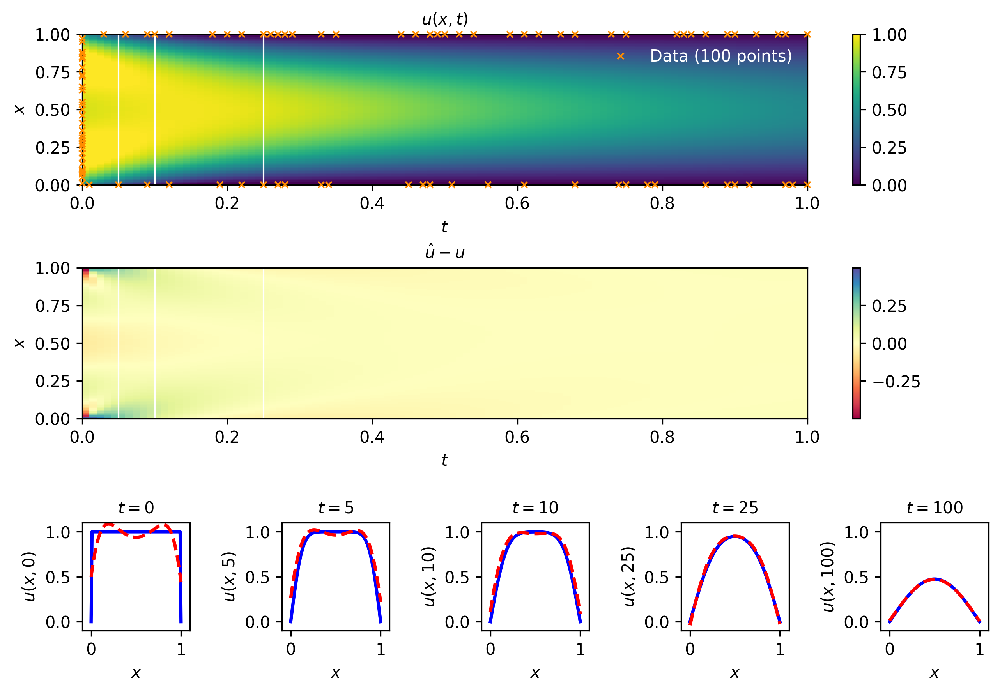

In [14]:
plot_2d(u_pred, x_u_train, u_train, exact_u, x, t, [0,5,10,25,100], True)

In case you used the callback, uncomment the following commands and remove the "/data/" part of the path in the `Video` call to create and embed a video of the training process. Otherwise you can execute the cell without changing anything to load the video from the lecture.

In [15]:
from IPython.display import Video

#!rm training_anim.mp4
#!ffmpeg -r 8 -s 600x600 -i Anim/1D_Heat_%01d.png -vcodec libx264 -crf 15 -pix_fmt yuv420p training_anim.mp4 -hide_banner -loglevel error

Video("/data/training_anim.mp4", width=900, embed=True)

The following cell will delete all images in the `Anim` folder you may have created by using the callback. This is to prevent the server from becoming too cluttered and the submission taking too long.

In [16]:
# delete .pngs and video before submitting
!rm Anim/*.png
!rm training_anim.mp4

rm: cannot remove 'Anim/*.png': No such file or directory
rm: cannot remove 'training_anim.mp4': No such file or directory


A few things are noticable here. As mentioned in the lecture, deep ANNs tend to learn low frequency parts of the solution quickly. If you take a look at the video, the PINN learns the simple harmonic parts of the solution easily, but has trouble approximating the rectangular and near rectangular field shapes around $t = 0$. As explained in the lecture, this is connected to needing a lot of Fourier components (think basis vectors) to approximate non-smooth fields like this. It takes a long time for the network to learn these shapes. 

Things that help are *residual connections* against vanishing gradients and *Fourier features* against spectral bias. And, of course, using L-BFGS instead of adam.

---